#### copy of this notebook can be found - https://github.com/derekbanas/plotly-tutorial/blob/master/Plotly%20Tut.ipynb
#### youtube video link - Derek Banas - https://www.youtube.com/watch?v=GGL6U0k8WYA
#### Plotly colorscales - https://plotly.com/python/builtin-colorscales/

### Packages to install
- pip install plotly
- pip install cufflinks
- pip install chart-studio
- pip install seaborn

In [1]:
import pandas as pd
import numpy as np
import chart_studio.plotly as py
import cufflinks as cf
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
%matplotlib inline

# Make Plotly work in your Jupyter Notebook
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)
# Use Plotly locally
cf.go_offline()

## Basics

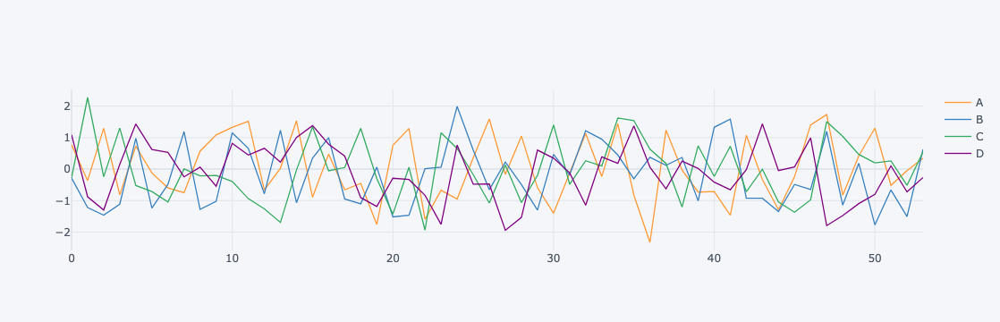

In [2]:
arr_1 = np.random.randn(54,4)
df1 = pd.DataFrame(arr_1,columns=['A','B','C','D'])
df1.head()
df1.iplot()

### Basic Line Plots

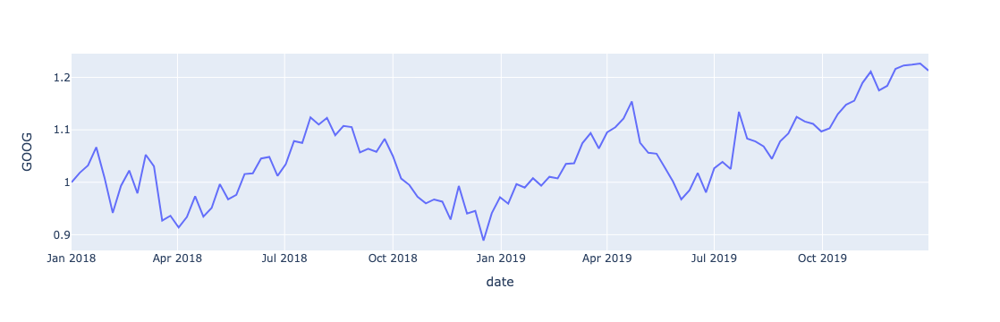

In [3]:
stock_data = px.data.stocks()
px.line(stock_data, x='date', y='GOOG', labels={'x':'Date', 'y':'Price'})

### Multiple Line Plots - dictionary

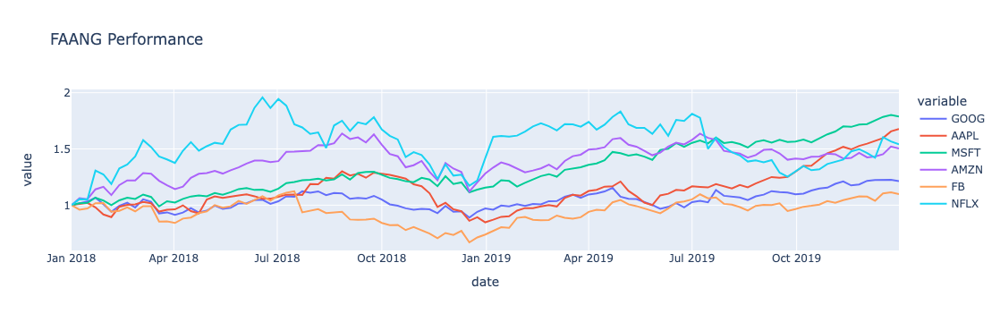

In [4]:
px.line(stock_data, x='date', y=['GOOG','AAPL','MSFT','AMZN','FB','NFLX'], labels={'x':'Date', 'y':'Price'}, title='FAANG Performance')

### Customising charts

- fig = go.Figure()
- fig.add_trace()
- fig.update_traces()
- fig.update_layout()
- fig.show()
- fig.iplot()

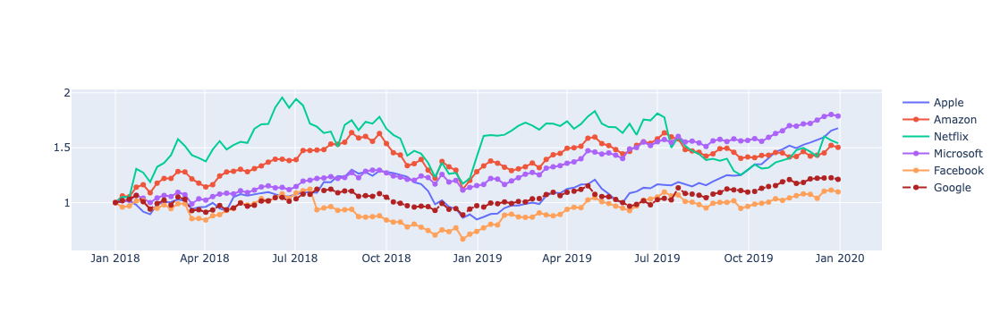

In [5]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=stock_data.date, y=stock_data.AAPL, mode='lines', name='Apple'))
fig.add_trace(go.Scatter(x=stock_data.date, y=stock_data.AMZN, mode='lines+markers', name='Amazon'))
fig.add_trace(go.Scatter(x=stock_data.date, y=stock_data.NFLX, mode='lines', name='Netflix'))
fig.add_trace(go.Scatter(x=stock_data.date, y=stock_data.MSFT, mode='lines+markers', name='Microsoft'))
fig.add_trace(go.Scatter(x=stock_data.date, y=stock_data.FB, mode='lines+markers', name='Facebook'))
fig.add_trace(go.Scatter(x=stock_data.date, y=stock_data.GOOG, mode='lines+markers', name='Google',line=dict(color='firebrick',width=2,dash='dashdot')))

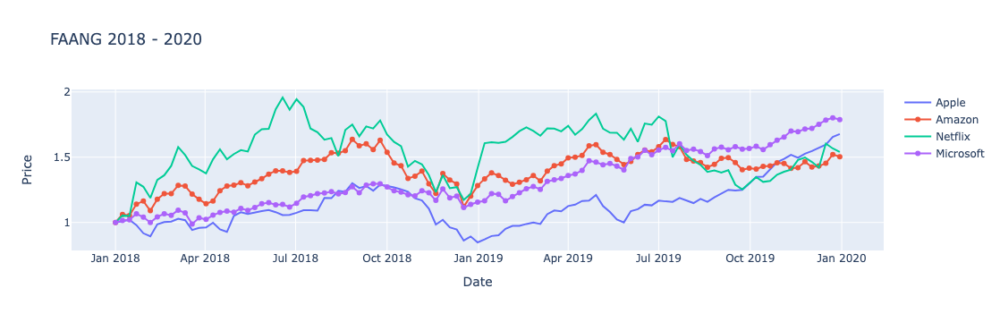

In [6]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=stock_data.date, y=stock_data.AAPL, mode='lines', name='Apple'))
fig.add_trace(go.Scatter(x=stock_data.date, y=stock_data.AMZN, mode='lines+markers', name='Amazon'))
fig.add_trace(go.Scatter(x=stock_data.date, y=stock_data.NFLX, mode='lines', name='Netflix'))
fig.add_trace(go.Scatter(x=stock_data.date, y=stock_data.MSFT, mode='lines+markers', name='Microsoft'))
fig.update_layout(title='FAANG 2018 - 2020',xaxis_title='Date',yaxis_title='Price')

### Making grid changes to the layout

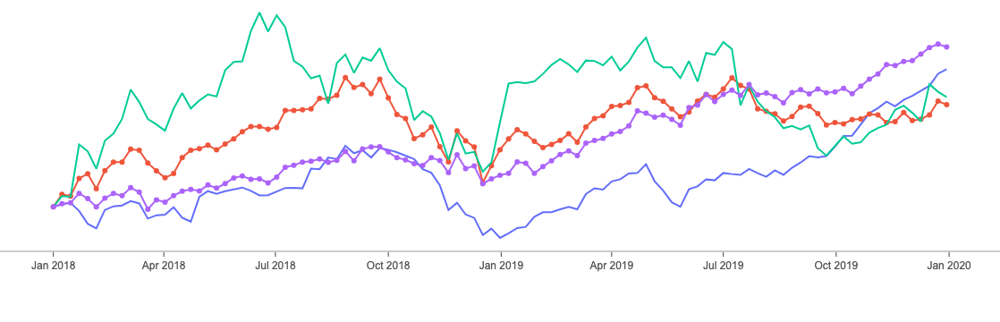

In [7]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=stock_data.date, y=stock_data.AAPL, mode='lines', name='Apple'))
fig.add_trace(go.Scatter(x=stock_data.date, y=stock_data.AMZN, mode='lines+markers', name='Amazon'))
fig.add_trace(go.Scatter(x=stock_data.date, y=stock_data.NFLX, mode='lines', name='Netflix'))
fig.add_trace(go.Scatter(x=stock_data.date, y=stock_data.MSFT, mode='lines+markers', name='Microsoft'))

fig.update_layout(
    # Shows gray line without grid, styling fonts, linewidths and more
    xaxis=dict(
        showline=True,
        showgrid=False,
        showticklabels=True,
        linecolor='rgb(204, 204, 204)',
        linewidth=2,
        ticks='outside',
        tickfont=dict(
            family='Arial',
            size=12,
            color='rgb(82, 82, 82)',
        ),
    ),
    # Turn off everything on y axis
    yaxis=dict(
        showgrid=False,
        zeroline=False,
        showline=False,
        showticklabels=False,
    ),
    autosize=True,
    margin=dict(
        autoexpand=False,
        l=0,
        r=0,
        t=0,
    ),
    showlegend=True,
    plot_bgcolor='white'
)

### Bar Charts

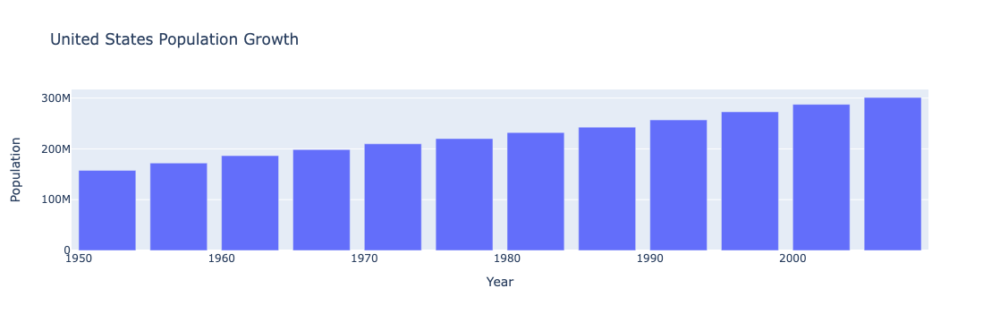

In [8]:
us_data = px.data.gapminder().query("country == 'United States'")
px.bar(us_data, x='year', y='pop', title='United States Population Growth', labels={'year':'Year', 'pop':'Population'})

### Create Stacked Bar Chart

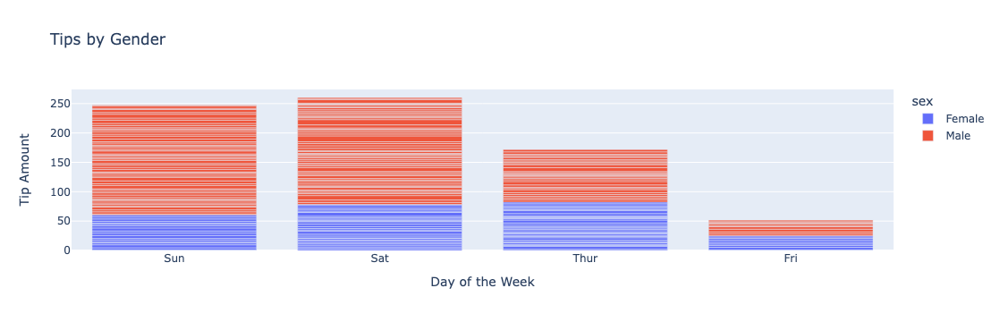

In [9]:
tips_data= px.data.tips()
px.bar(tips_data,x='day', y='tip', title='Tips by Gender', labels={'tip':'Tip Amount','day':'Day of the Week'}, color='sex')

### Stacked next to each other
- use : barmode

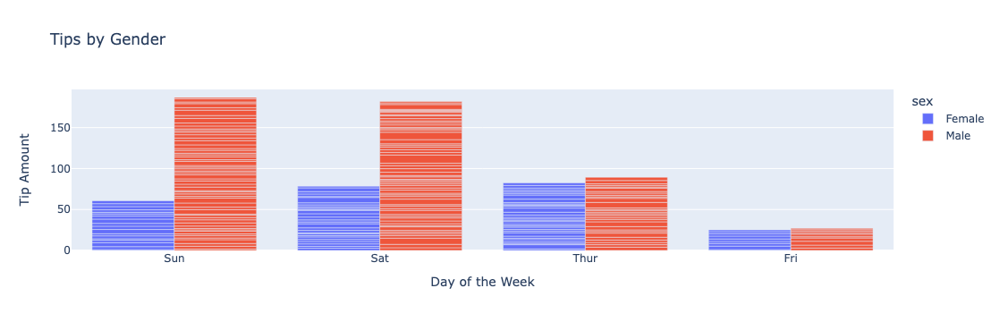

In [27]:
px.bar(tips_data,
       x='day', y='tip', 
       title='Tips by Gender', 
       labels={'tip':'Tip Amount','day':'Day of the Week'}, 
       color='sex', barmode='group')

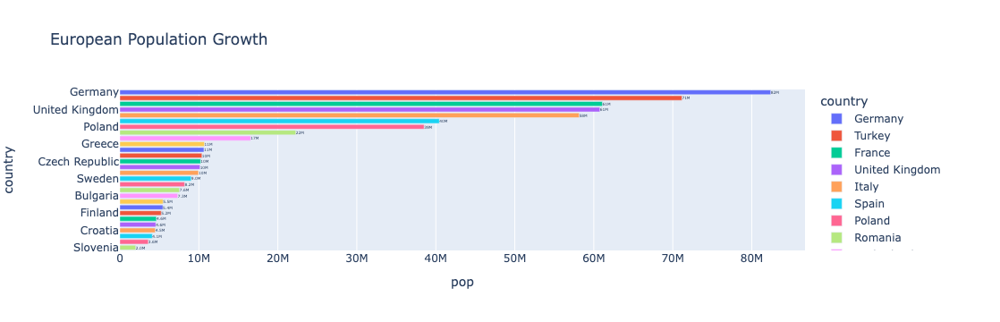

In [57]:
eu_data = px.data.gapminder().query("continent == 'Europe' and year == 2007 and pop >2.e6")
eu_data = eu_data.sort_values(by='pop', ascending=False)
fig = px.bar(eu_data,y='country', x='pop', title='European Population Growth', text='pop',color='country', orientation='h')
fig.update_traces(texttemplate='%{text:.2s}', textposition='outside', textfont_size=20)
fig.update_layout(uniformtext_minsize=20)
fig

### Scatter Plots

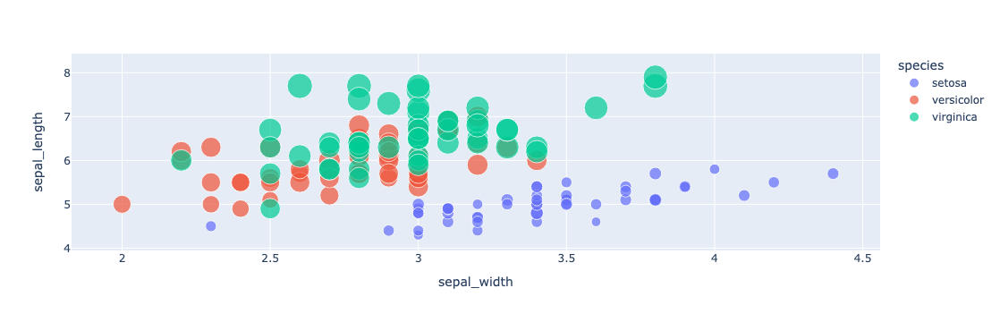

In [25]:
iris_data = px.data.iris()
px.scatter(
    iris_data,
    x='sepal_width', y='sepal_length',
    color='species',
    size='petal_length',
    hover_data=['petal_width'])


### Customize Scatter Plot

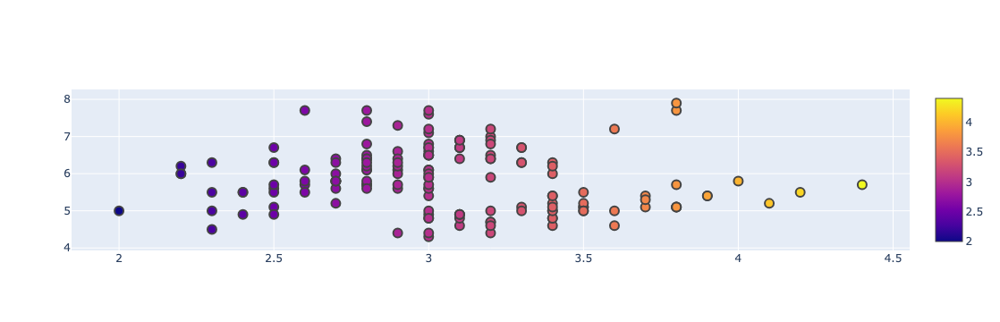

In [29]:
fig=go.Figure()

fig.add_trace(go.Scatter(
    x = iris_data.sepal_width, y = iris_data.sepal_length,
    mode ='markers',
    marker_color = iris_data.sepal_width,
    marker = dict(showscale=True),
    text = iris_data.species,))

fig.update_traces(
    marker_line_width=2,
    marker_size=10)


### Use Scattergl - for big datasets

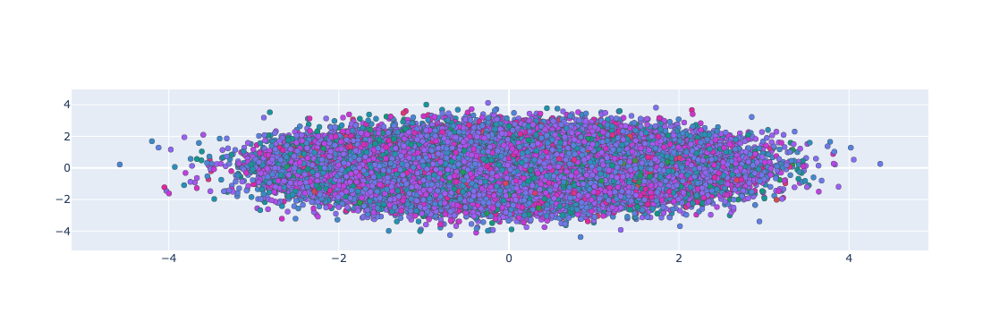

In [43]:
fig = go.Figure(data=go.Scattergl(
    x = np.random.randn(100000),
    y = np.random.randn(100000),
    mode = 'markers',
    marker = dict(
        color = np.random.randn(100000),
        colorscale = 'Phase',
        line_width = .5
    )))
fig.iplot()

#### Pie Charts

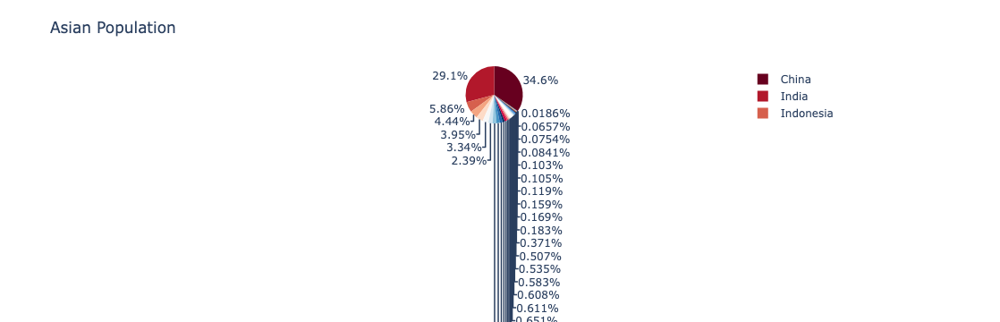

In [47]:
asia_data = px.data.gapminder().query("year == 2007").query("continent == 'Asia'")
px.pie(
    asia_data,
    values = 'pop',
    names = 'country',
    title = 'Asian Population',
    color_discrete_sequence=px.colors.sequential.RdBu,)

### Custom PIE chart

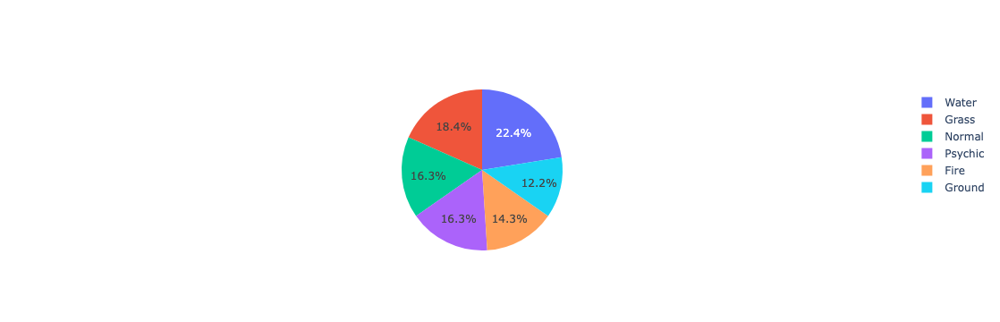

In [51]:
colors = ['blue','green','black','purple','red','brown']
fig = go.Figure(
    data=[go.Pie(
        labels=['Water','Grass','Normal','Psychic','Fire','Ground'],
        values=[110,90,80,80,70,60],
    )]
)
fig.show()

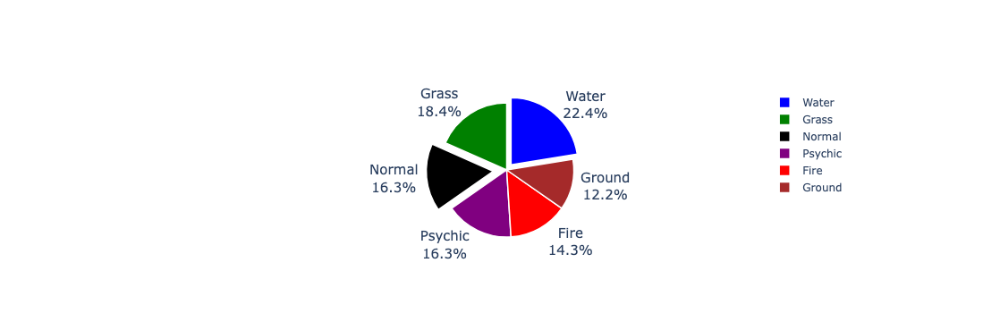

In [65]:
colors = ['blue','green','black','purple','red','brown']
fig = go.Figure(
    data=[go.Pie(
        labels=['Water','Grass','Normal','Psychic','Fire','Ground'],
        values=[110,90,80,80,70,60]),
])
fig.update_traces(
    hoverinfo='label+percent', 
    textfont_size=15,
    textinfo='label+percent',
    pull=[0.1,0,0.2,0,0,0],
    marker=dict(colors=colors,
               line=dict(
                   color='#FFFFFF',
                   width=1.5))
)
fig.show()

### Histogram

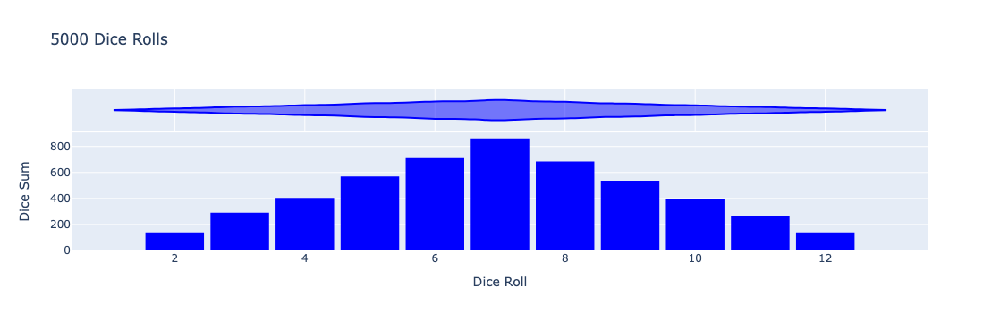

In [70]:
dice_1 = np.random.randint(1,7,5000)
dice_2 = np.random.randint(1,7,5000)
dice_sum = dice_1 + dice_2
fig = px.histogram(
    dice_sum, nbins=11,
    title='5000 Dice Rolls',
    marginal='violin',
    color_discrete_sequence=['blue']
)
fig.update_layout(
    xaxis_title_text='Dice Roll',
    yaxis_title_text='Dice Sum',
    bargap=0.1,
    showlegend=False
)
fig.show()

### Stacked Histogram

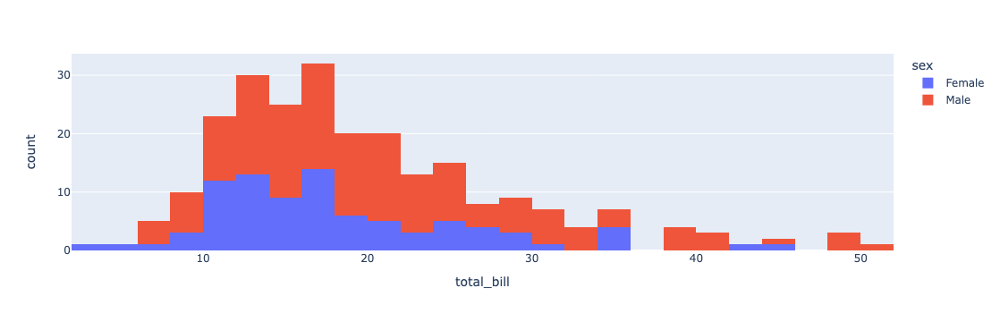

In [72]:
tips_data = px.data.tips()
px.histogram(tips_data,
            x='total_bill',
            color='sex',
            )

### Box Plots

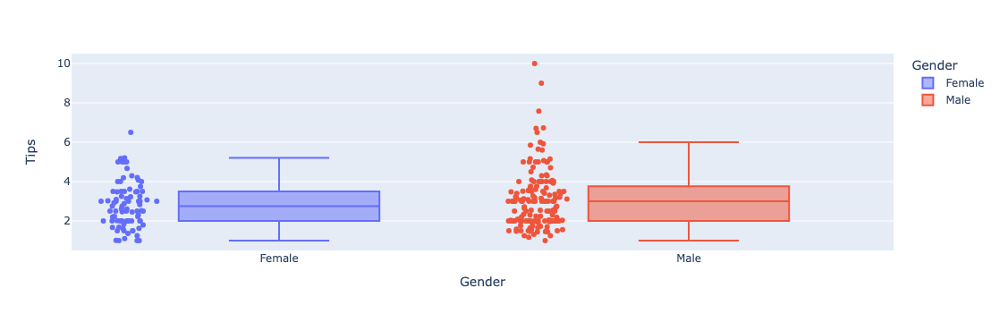

In [76]:
px.box(tips_data,
      x='sex',
      y='tip',
      points='all',
      color='sex',
      labels={'tip':'Tips', 'sex':'Gender'})

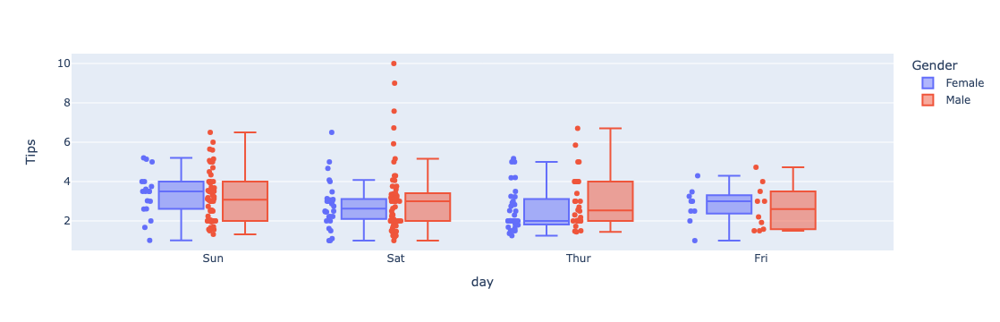

In [79]:
px.box(tips_data,
      x='day',
      y='tip',
      points='all',
      color='sex',
      labels={'tip':'Tips', 'sex':'Gender'})

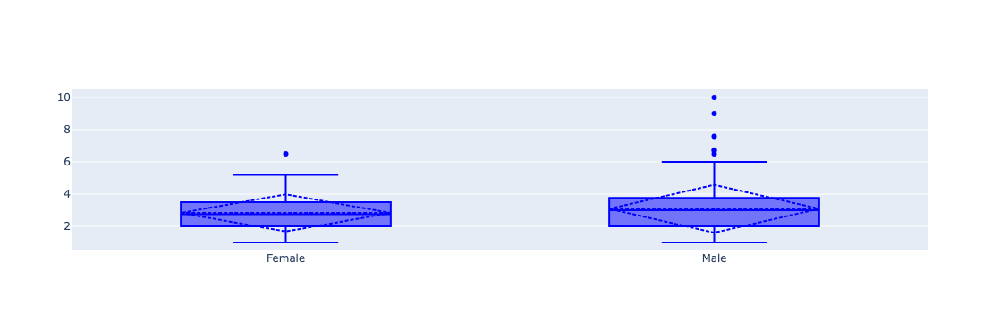

In [83]:
fig=go.Figure()
fig.add_trace(go.Box(
    x=tips_data.sex, y=tips_data.tip,
    marker_color='blue',
    boxmean='sd',)
)

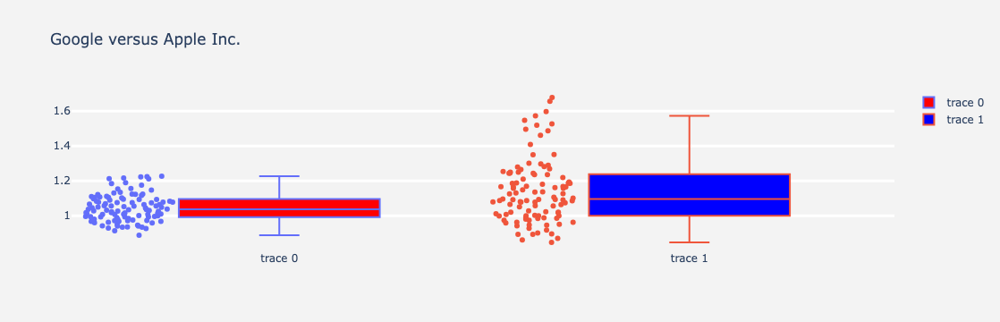

In [85]:
fig = go.Figure()
fig.add_trace(go.Box(
    y=stock_data.GOOG,
    boxpoints='all',
    fillcolor='red',
    jitter=0.5,
    whiskerwidth=0.2))

fig.add_trace(go.Box(
    y=stock_data.AAPL,
    boxpoints='all',
    fillcolor='blue',
    jitter=0.5,
    whiskerwidth=0.2))
fig.update_layout(
    title='Google versus Apple Inc.',
    yaxis=dict(
    gridcolor='rgb(255,255,255,255)',
    gridwidth=3),
paper_bgcolor='rgb(243,243,243)',
plot_bgcolor='rgb(243,243,243)'
)

### Violin Plot

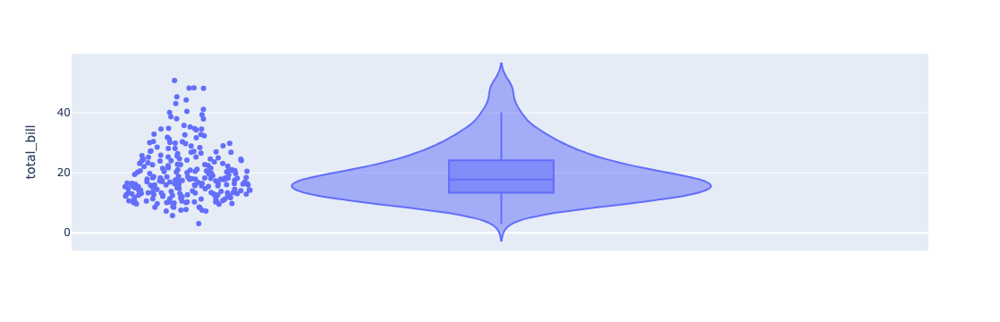

In [87]:
px.violin(
    tips_data,
    y='total_bill',
    box=True,
    points='all')


### Show multuple information on violin plot

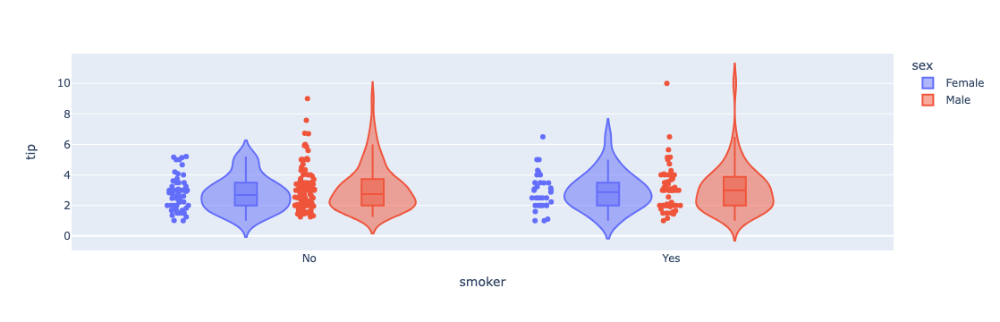

In [89]:
px.violin(
    tips_data,
    x='smoker',
    y='tip',
    color='sex',
    box=True,
    points='all',
    hover_data=tips_data.columns)

### Density Maps

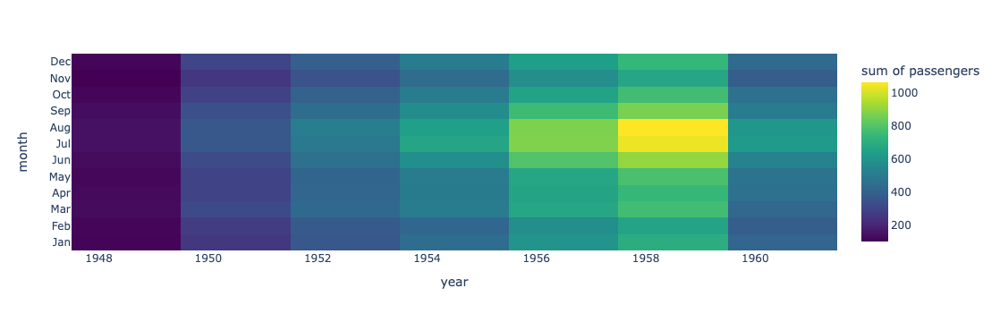

In [94]:
flights = sns.load_dataset('flights') ### dataset is from seaborn
flights
fig=px.density_heatmap(flights, x='year', y='month', z='passengers', color_continuous_scale='Viridis')
fig.show()

### 3D ScatterPlot

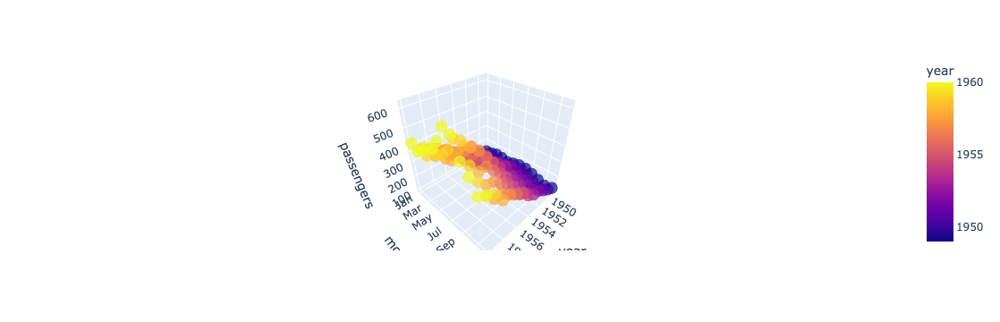

In [98]:
fig = px.scatter_3d(
    flights,
    x='year', y='month', z='passengers', color='year', opacity=0.7
)
fig.show()

### 3D Line Plot

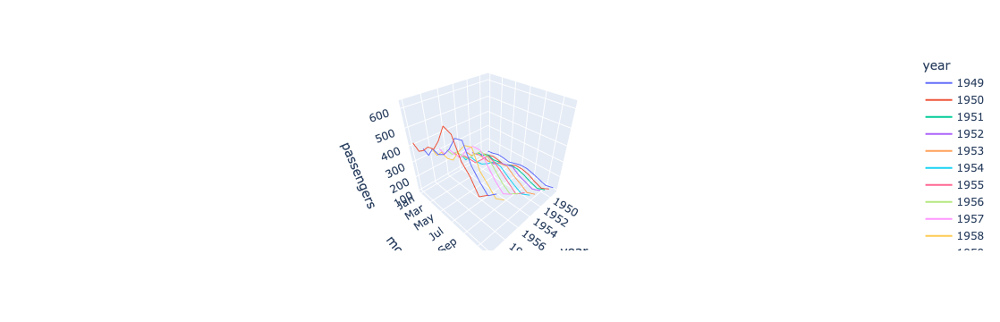

In [101]:
fig = px.line_3d(
    flights,
    x='year', y='month', z='passengers', color='year',
)
fig.show()

### Scatter Matrix

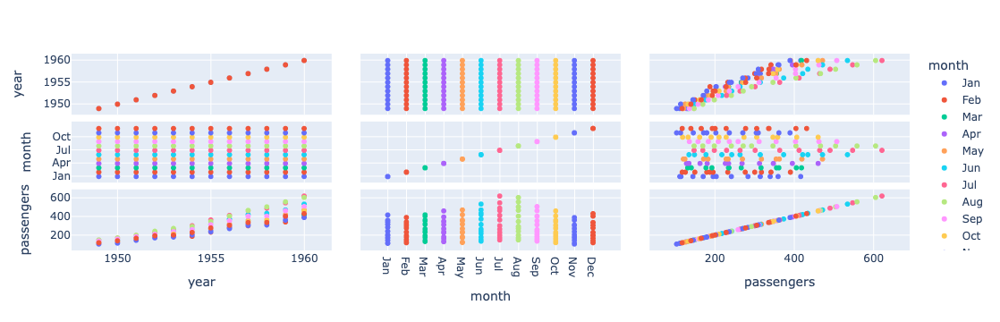

In [103]:
fig=px.scatter_matrix(flights,color='month')
fig.iplot()

### Map Scatter Plot (World Map)

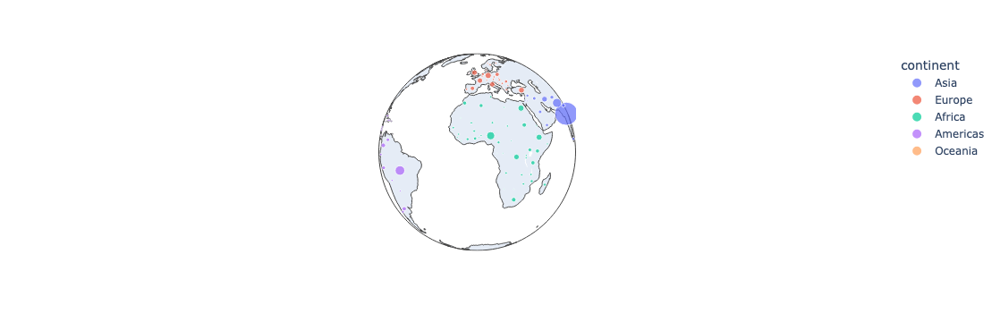

In [106]:
world_map = px.data.gapminder().query("year==2007")
fig = px.scatter_geo(world_map,
                    locations='iso_alpha',
                    color='continent',
                    hover_name='country',
                    size='pop',
                    projection='orthographic')
fig.show()


### Choropleth Maps

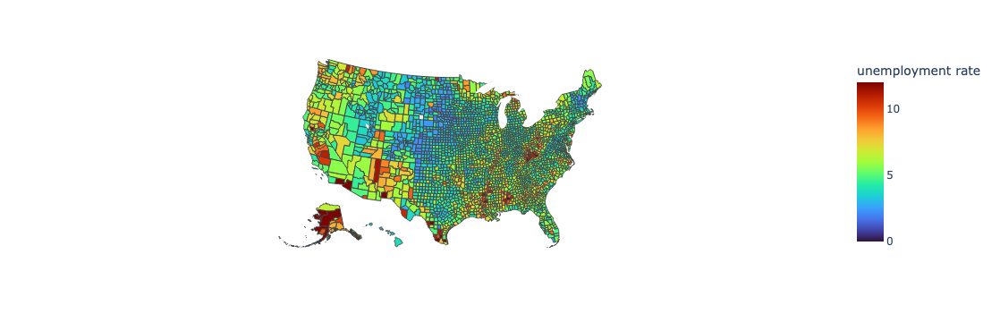

In [109]:
# You can color complex maps like we do here representing unemployment data

# Allows us to grab data from a supplied URL
from urllib.request import urlopen
# Used to decode JSON data
import json
# Grab US county geometry data
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

# Grab unemployment data based on each counties Federal Information Processing number
df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/fips-unemp-16.csv",
                   dtype={"fips": str})

# Draw map using the county JSON data, color using unemployment values on a range of 12
fig = px.choropleth(df, geojson=counties, locations='fips', color='unemp',
                           color_continuous_scale="Turbo",
                           range_color=(0, 12),
                           scope="usa",
                           labels={'unemp':'unemployment rate'}
                          )
fig.show()

### Polar Charts

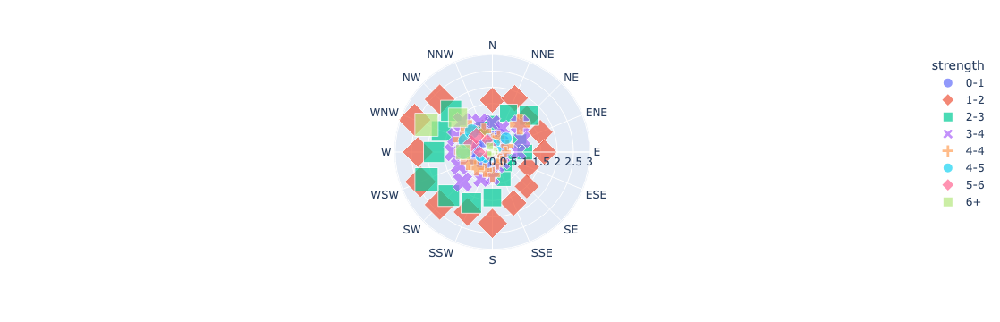

In [113]:
wind_data = px.data.wind()
px.scatter_polar(wind_data, r='frequency', theta='direction', color='strength', size='frequency', symbol='strength')

### Line Polar Charts

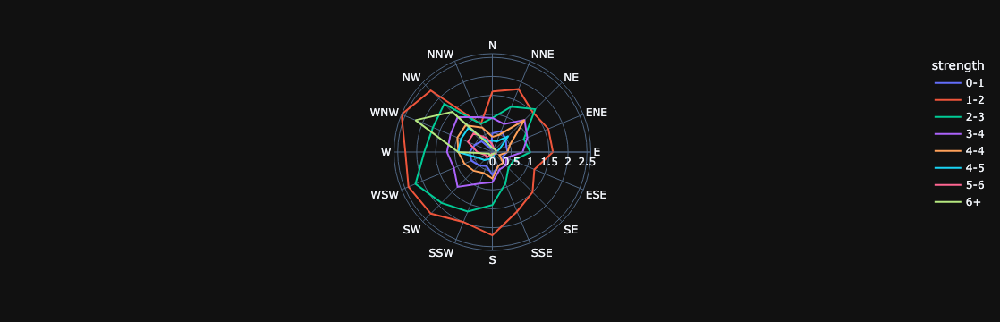

In [117]:
px.line_polar(wind_data, r='frequency', theta='direction', color='strength', line_close=True, template='plotly_dark')

### Ternary Plots

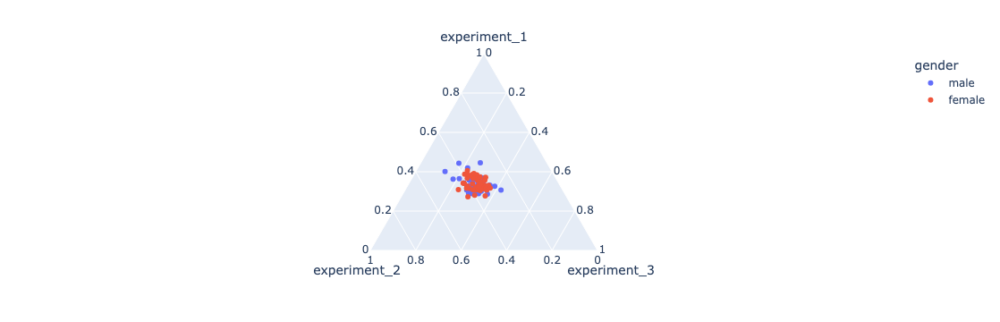

In [123]:
exp_data = px.data.experiment()
px.scatter_ternary(exp_data, a='experiment_1',b='experiment_2', c='experiment_3', hover_name='group', color='gender')

### Facet Plot -- provides invidual small plots

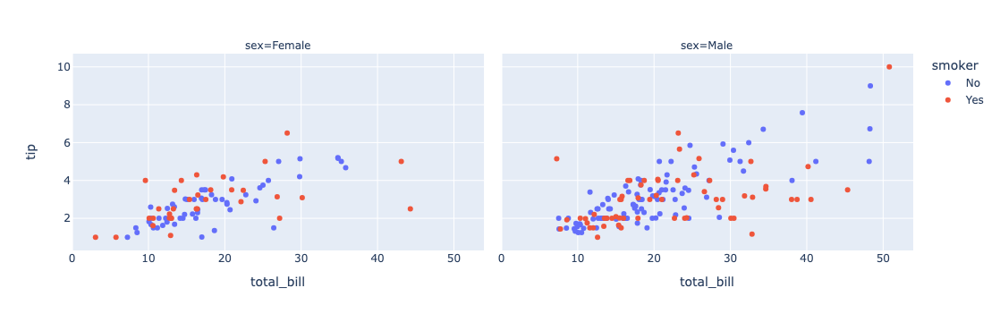

In [126]:
px.scatter(tips_data,x='total_bill', y='tip', color='smoker', facet_col='sex')

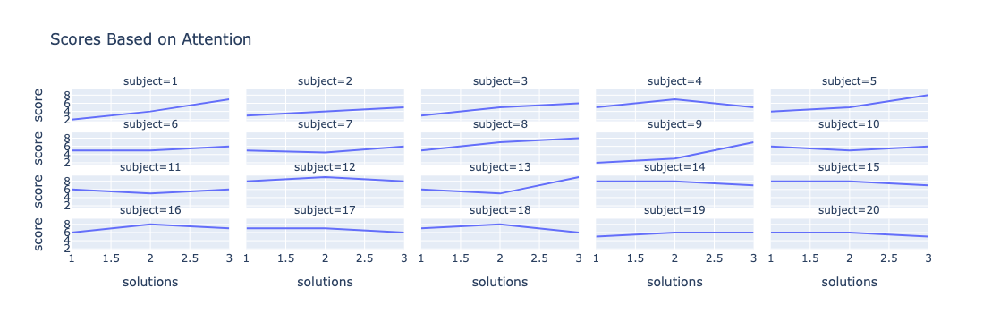

In [127]:
att_df = sns.load_dataset("attention")
fig = px.line(att_df, x='solutions', y='score', facet_col='subject',
             facet_col_wrap=5, title='Scores Based on Attention')
fig


### Animated Plots

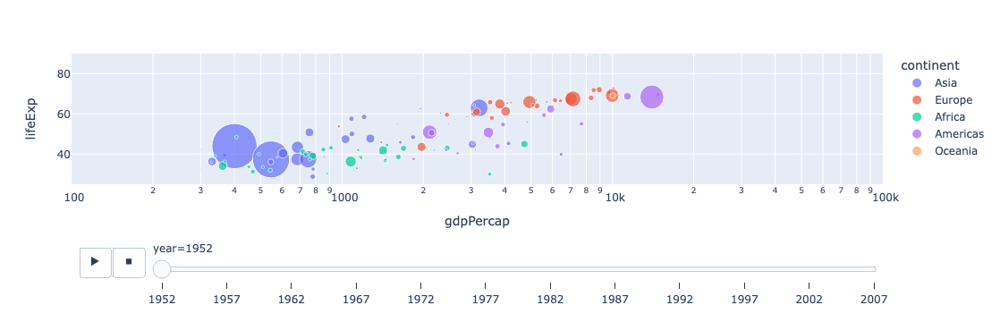

In [128]:
df_cnt = px.data.gapminder()
px.scatter(df_cnt, x="gdpPercap", y="lifeExp", animation_frame="year", 
           animation_group="country",
           size="pop", color="continent", hover_name="country",
           log_x=True, size_max=55, range_x=[100,100000], range_y=[25,90])

### Bar Chart Animated Plot

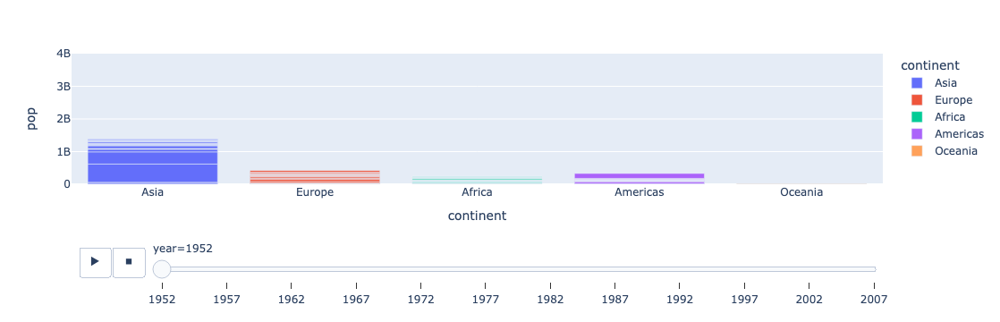

In [129]:
# Watch as bars chart population changes
px.bar(df_cnt, x="continent", y="pop", color="continent",
  animation_frame="year", animation_group="country", range_y=[0,4000000000])